<a href="https://colab.research.google.com/github/khoa030602/flower/blob/main/Flower.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [40]:
import matplotlib.pyplot as plt
from keras.layers import LeakyReLU
import numpy as np
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, Conv2D, MaxPooling2D, Flatten
from keras.utils import to_categorical
from keras.models import load_model
from keras.utils import load_img, img_to_array
import os
from keras.preprocessing.image import ImageDataGenerator

In [41]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [42]:
train_data=ImageDataGenerator(rescale=1./255, shear_range=0.2, zoom_range=0.2, horizontal_flip=True)

In [44]:
training_set=train_data.flow_from_directory('/content/drive/MyDrive/AI/Data/Flower/Train',target_size=(150,150), batch_size=32, class_mode='categorical')

Found 130 images belonging to 5 classes.


In [45]:
training_set.class_indices

{'Boconganh': 0, 'Cuc': 1, 'Hong': 2, 'Huongduong': 3, 'Tulip': 4}

In [46]:
# Tạo ra mạng CNN để train mô hình
model=Sequential()
model.add(Conv2D(32,kernel_size=(3,3), activation='relu', input_shape=(150,150,3), padding='same')) 
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(2,2))

model.add(Conv2D(64,kernel_size=(3,3), activation='relu', padding='same'))
model.add(LeakyReLU(alpha=0.1)) 
model.add(MaxPooling2D(2,2))

model.add(Conv2D(128,kernel_size=(3,3), activation='relu', padding='same')) 
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(2,2))

#ANN
model.add(Flatten())
model.add(Dense(256,activation='relu'))
model.add(LeakyReLU(alpha=0.1))
model.add(Dense(5,activation='softmax'))

#Compile
model.compile(loss='categorical_crossentropy',optimizer='Adam',metrics=['accuracy'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 150, 150, 32)      896       
                                                                 
 leaky_re_lu_13 (LeakyReLU)  (None, 150, 150, 32)      0         
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 75, 75, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 75, 75, 64)        18496     
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 75, 75, 64)        0         
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 37, 37, 64)       0         
 g2D)                                                 

In [48]:
train=model.fit(training_set,epochs=10,batch_size=128,verbose=1)

Epoch 1/10
5/5 [==============================] - 45s 526ms/step - loss: 4.2080 - accuracy: 0.2462
Epoch 2/10
5/5 [==============================] - 1s 213ms/step - loss: 1.6228 - accuracy: 0.1615
Epoch 3/10
5/5 [==============================] - 1s 208ms/step - loss: 1.5898 - accuracy: 0.4154
Epoch 4/10
5/5 [==============================] - 1s 284ms/step - loss: 1.6207 - accuracy: 0.1923
Epoch 5/10
5/5 [==============================] - 1s 215ms/step - loss: 1.5517 - accuracy: 0.3385
Epoch 6/10
5/5 [==============================] - 1s 220ms/step - loss: 1.5513 - accuracy: 0.3538
Epoch 7/10
5/5 [==============================] - 1s 210ms/step - loss: 1.5620 - accuracy: 0.3462
Epoch 8/10
5/5 [==============================] - 2s 389ms/step - loss: 1.3816 - accuracy: 0.4923
Epoch 9/10
5/5 [==============================] - 2s 310ms/step - loss: 1.5040 - accuracy: 0.4077
Epoch 10/10
5/5 [==============================] - 1s 214ms/step - loss: 1.1717 - accuracy: 0.5615


In [52]:
#Lưu
from keras.models import load_model
model.save("Hoa(CNN).h5")
model_1=load_model('Hoa(CNN).h5')

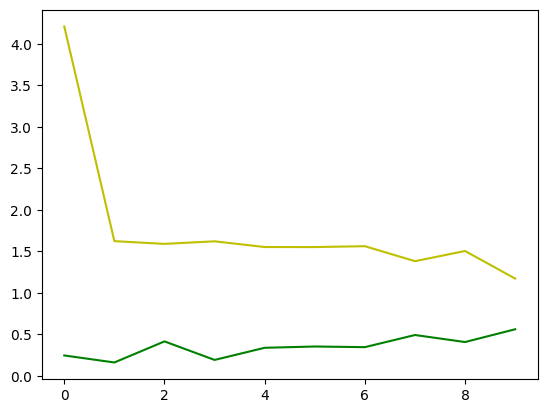

In [53]:
import matplotlib.pyplot as plt      
accuracy = train.history['accuracy']
loss = train.history['loss']    
epochs = range(len(accuracy))
plt.plot(epochs,accuracy,'g',label = 'Training accuracy')
plt.plot(epochs,loss,'y',label = 'Training loss')
plt.show()

1/1 [==============================] - 0s 219ms/step
Boconganh


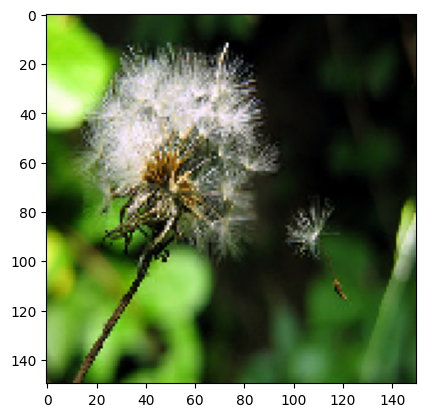

1/1 [==============================] - 0s 29ms/step
Cuc


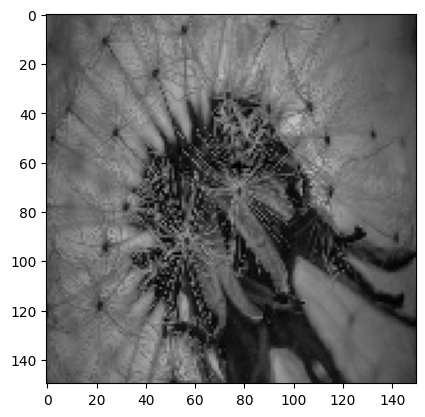

1/1 [==============================] - 0s 19ms/step
Cuc


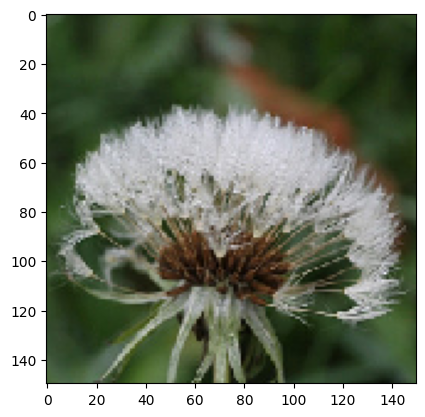

1/1 [==============================] - 0s 22ms/step
Cuc


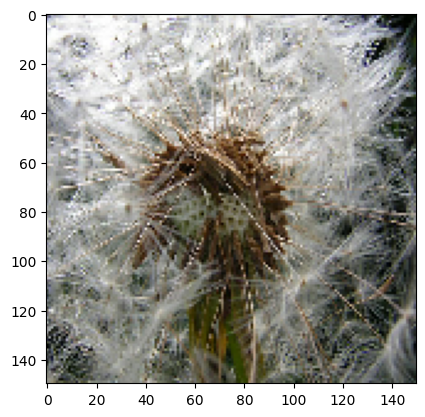

1/1 [==============================] - 0s 27ms/step
Cuc


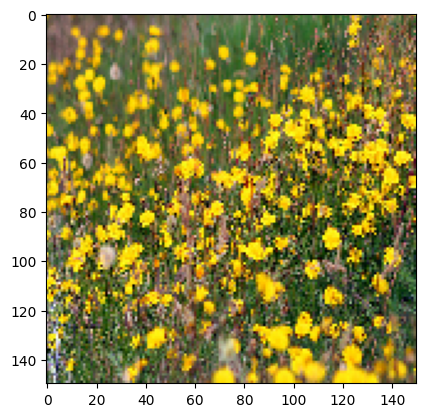

1/1 [==============================] - 0s 31ms/step
Cuc


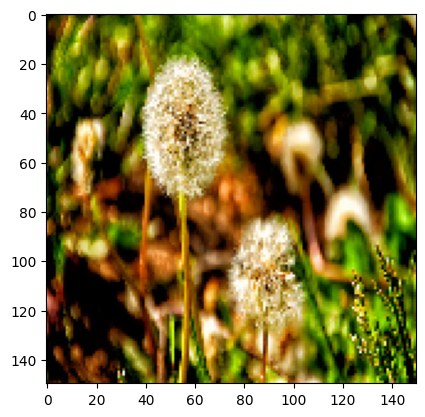

1/1 [==============================] - 0s 44ms/step
Cuc


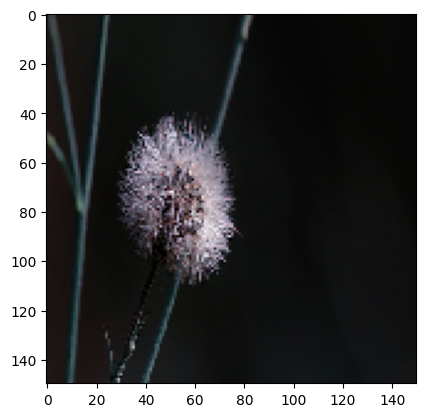

1/1 [==============================] - 0s 26ms/step
Boconganh


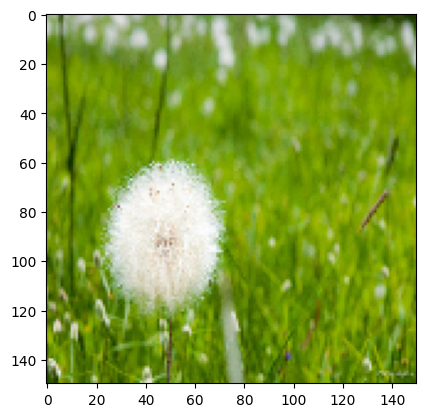

1/1 [==============================] - 0s 27ms/step
Boconganh


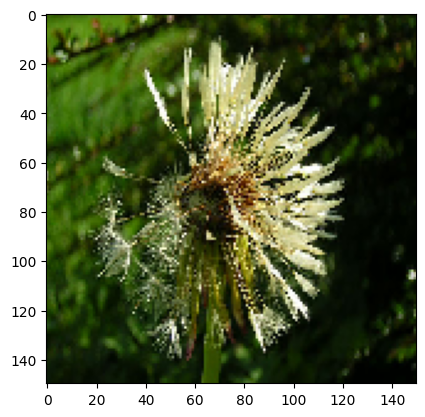

1/1 [==============================] - 0s 28ms/step
Cuc


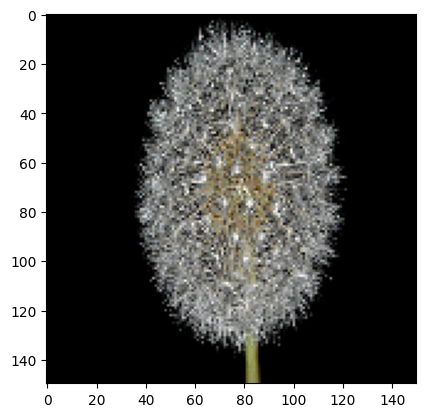

1/1 [==============================] - 0s 36ms/step
Boconganh


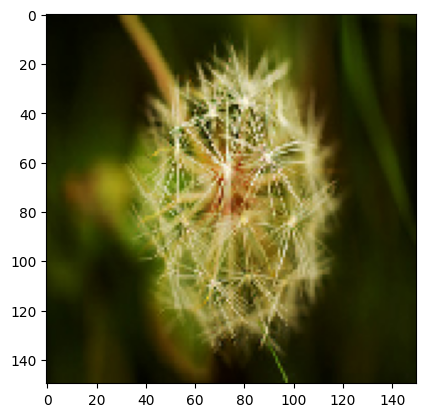

1/1 [==============================] - 0s 35ms/step
Boconganh


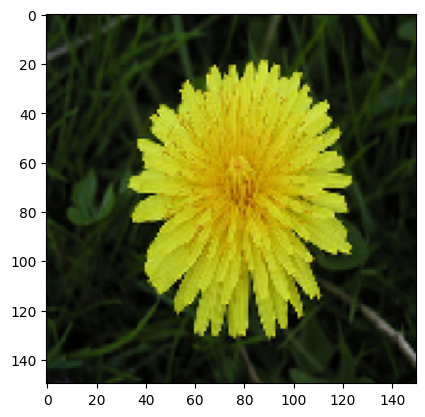

1/1 [==============================] - 0s 33ms/step
Boconganh


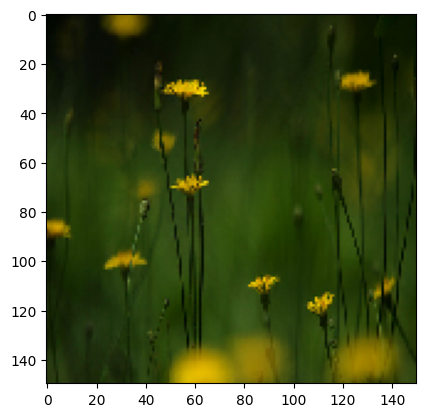

1/1 [==============================] - 0s 56ms/step
Cuc


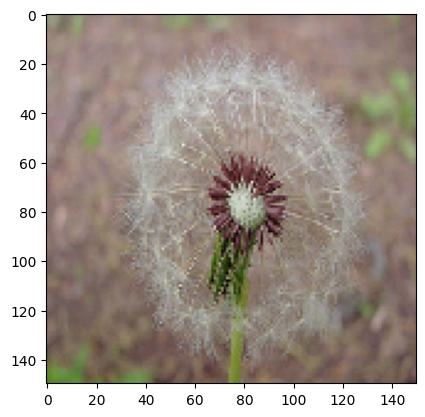

1/1 [==============================] - 0s 26ms/step
Boconganh


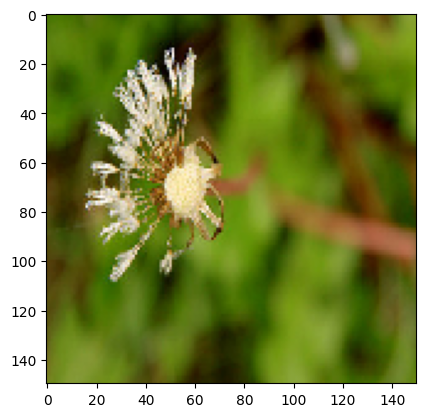

1/1 [==============================] - 0s 43ms/step
Cuc


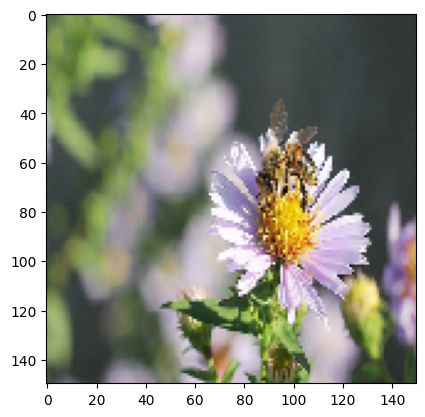

1/1 [==============================] - 0s 34ms/step
Cuc


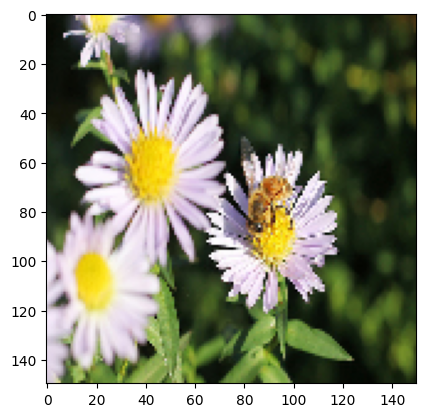

1/1 [==============================] - 0s 28ms/step
Cuc


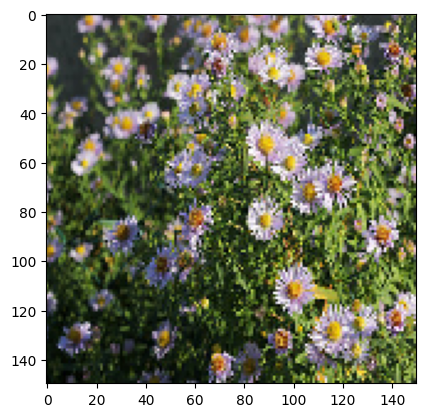

1/1 [==============================] - 0s 25ms/step
Cuc


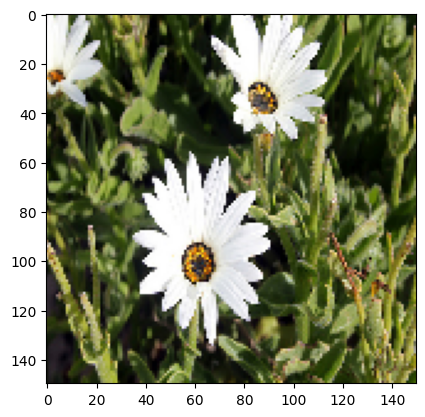

1/1 [==============================] - 0s 25ms/step
Cuc


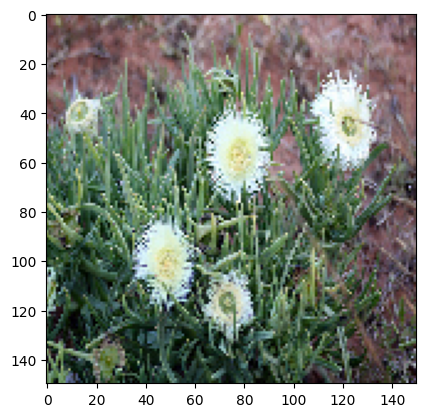

1/1 [==============================] - 0s 25ms/step
Cuc


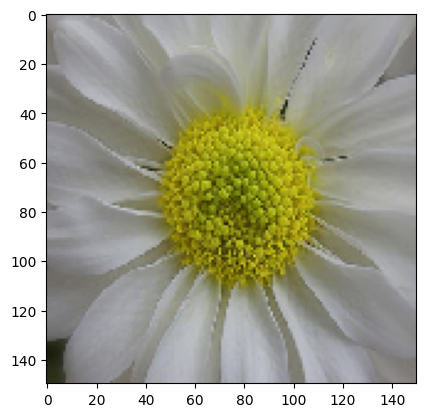

1/1 [==============================] - 0s 27ms/step
Cuc


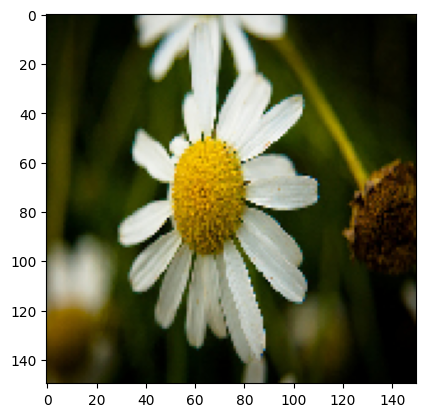

1/1 [==============================] - 0s 28ms/step
Cuc


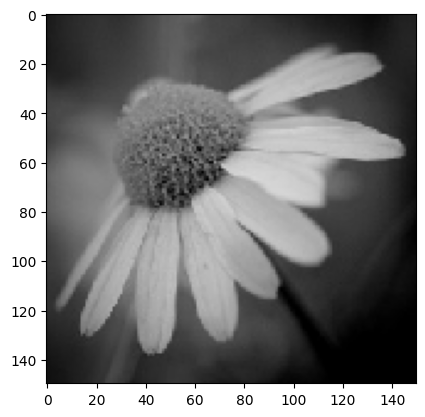

1/1 [==============================] - 0s 26ms/step
Cuc


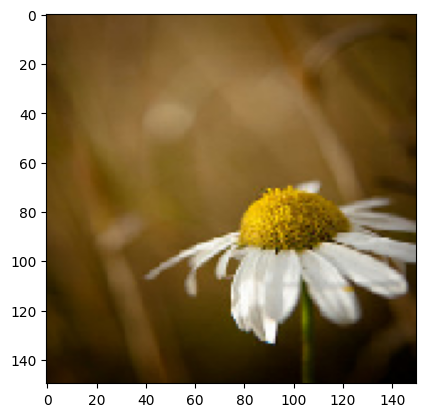

1/1 [==============================] - 0s 27ms/step
Boconganh


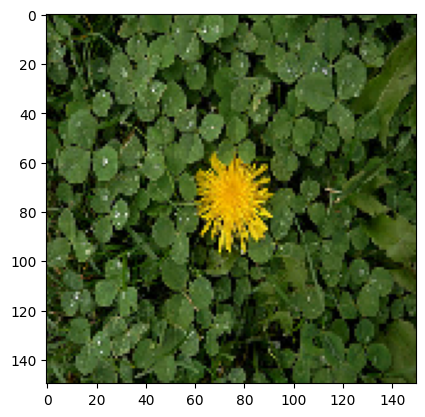

1/1 [==============================] - 0s 25ms/step
Cuc


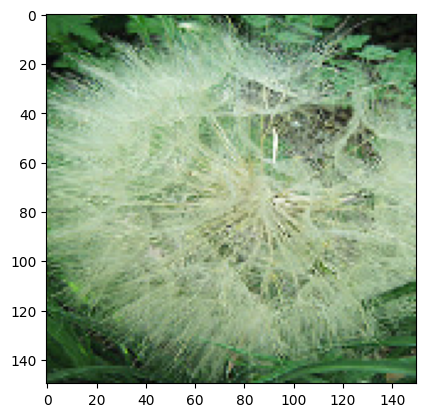

1/1 [==============================] - 0s 29ms/step
Cuc


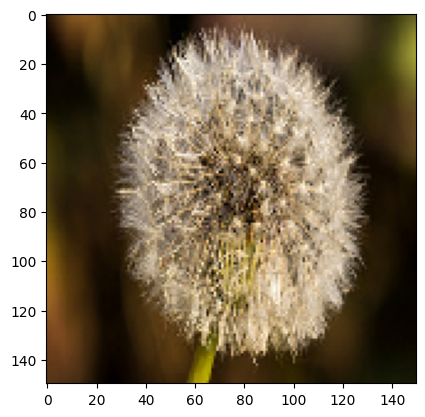

1/1 [==============================] - 0s 26ms/step
Boconganh


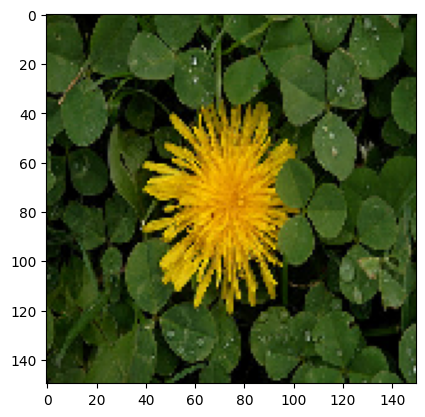

1/1 [==============================] - 0s 27ms/step
Boconganh


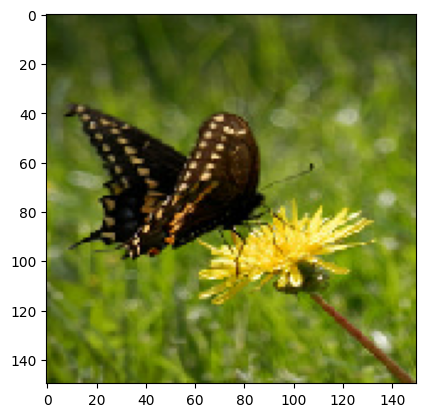

1/1 [==============================] - 0s 28ms/step
Cuc


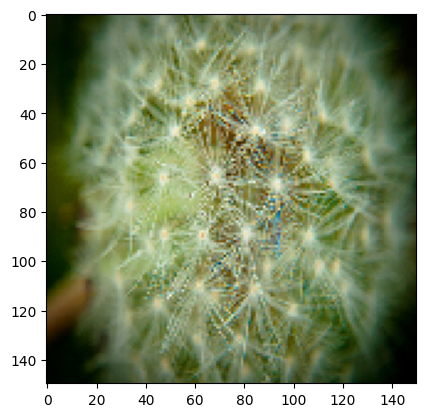

1/1 [==============================] - 0s 26ms/step
Cuc


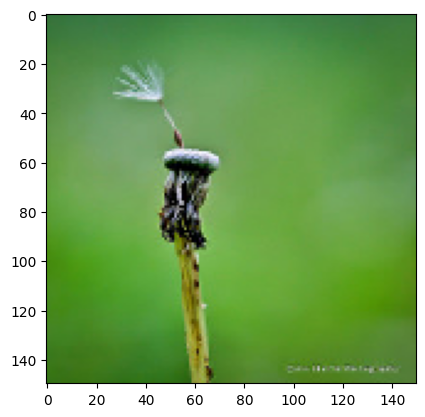

1/1 [==============================] - 0s 27ms/step
Cuc


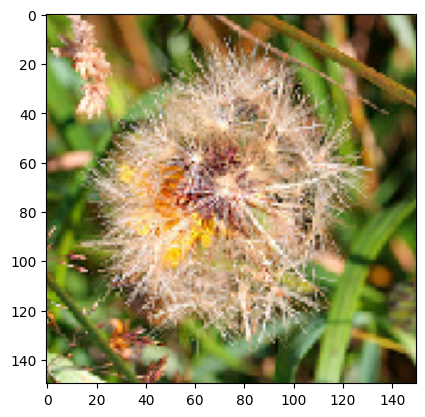

1/1 [==============================] - 0s 31ms/step
Cuc


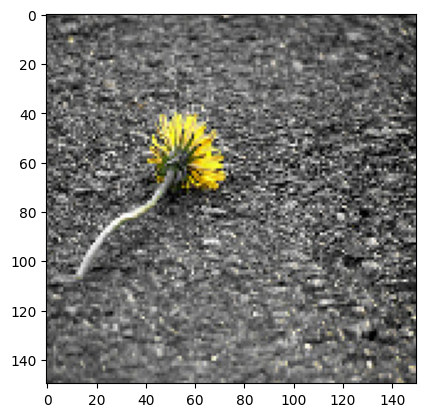

1/1 [==============================] - 0s 28ms/step
Boconganh


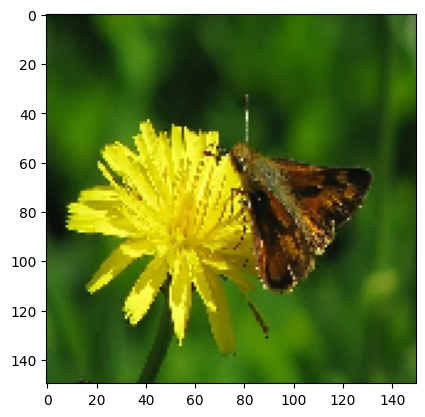

1/1 [==============================] - 0s 25ms/step
Cuc


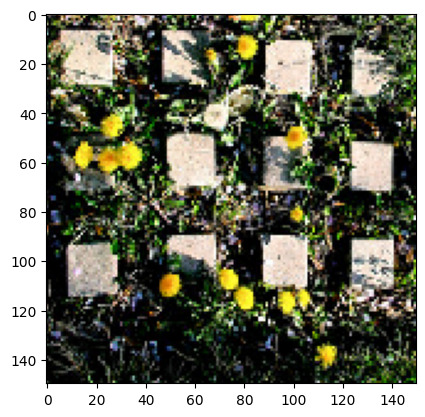

1/1 [==============================] - 0s 25ms/step
Cuc


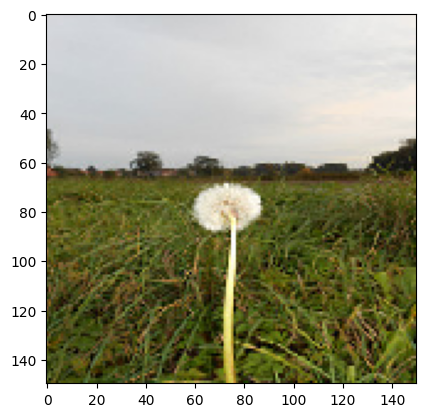

1/1 [==============================] - 0s 25ms/step
Cuc


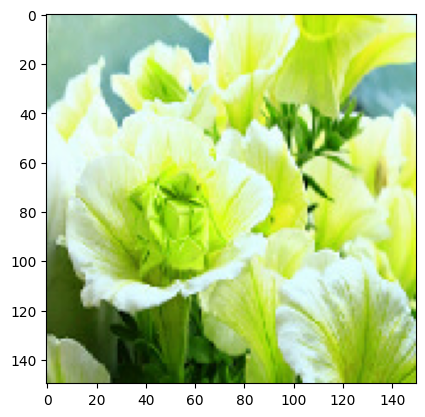

1/1 [==============================] - 0s 30ms/step
Boconganh


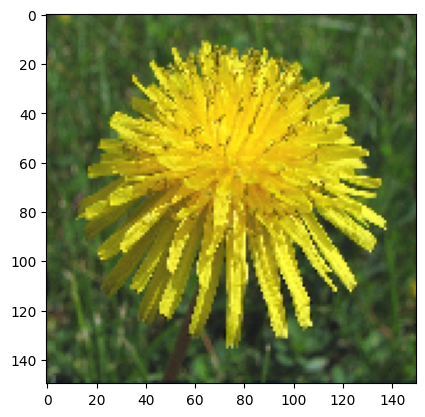

1/1 [==============================] - 0s 40ms/step
Cuc


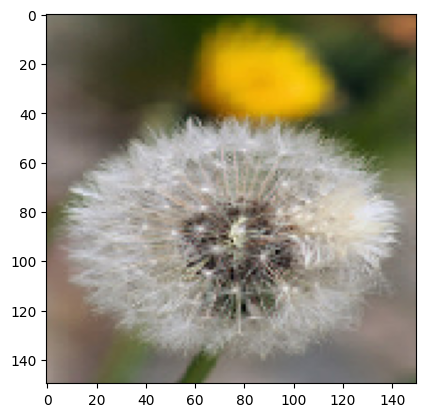

1/1 [==============================] - 0s 29ms/step
Cuc


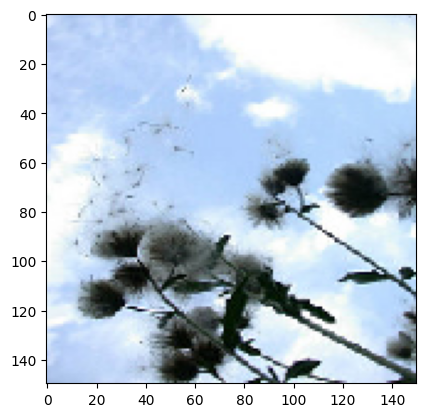

1/1 [==============================] - 0s 27ms/step
Cuc


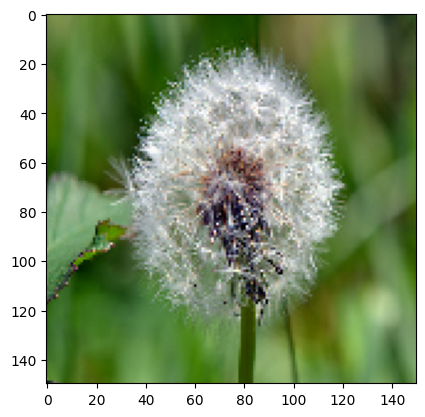

1/1 [==============================] - 0s 46ms/step
Cuc


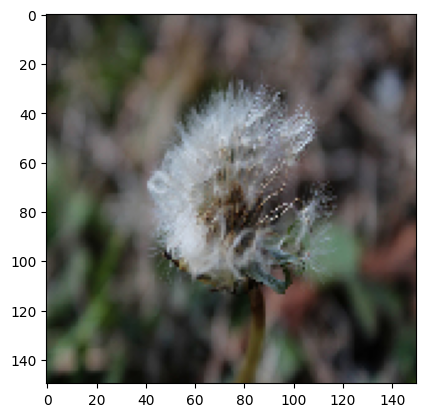

1/1 [==============================] - 0s 42ms/step
huongduong


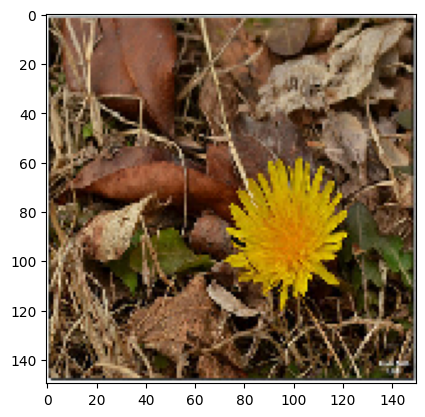

1/1 [==============================] - 0s 55ms/step
Cuc


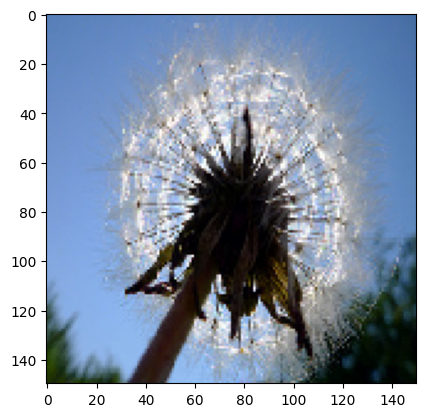

1/1 [==============================] - 0s 27ms/step
Cuc


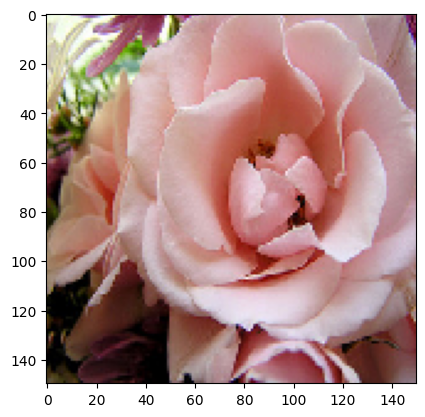

1/1 [==============================] - 0s 29ms/step
Cuc


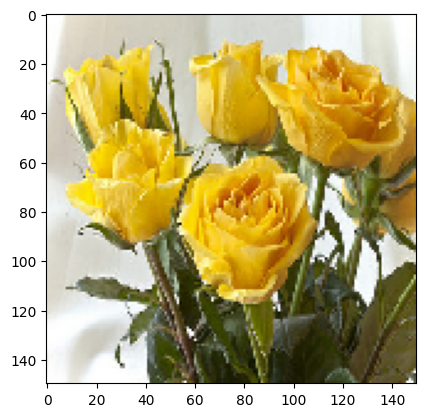

1/1 [==============================] - 0s 37ms/step
Cuc


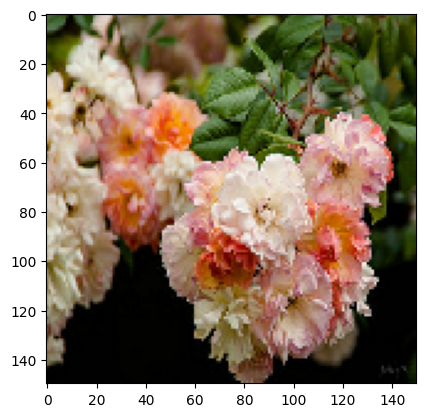

1/1 [==============================] - 0s 38ms/step
Hong


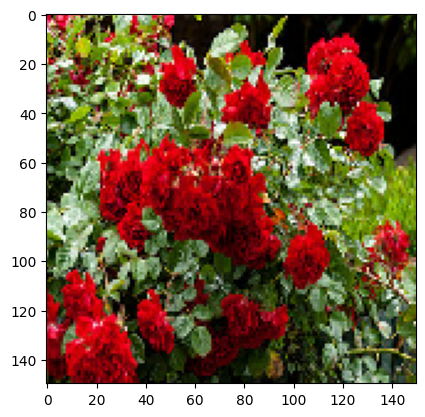

1/1 [==============================] - 0s 35ms/step
Cuc


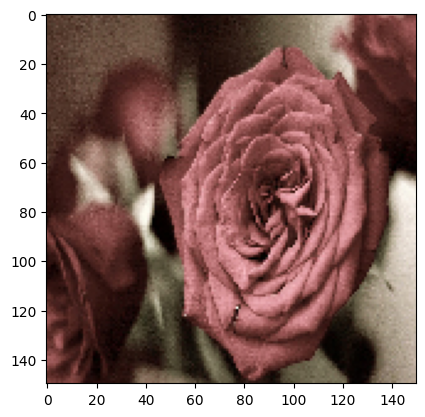

1/1 [==============================] - 0s 31ms/step
Cuc


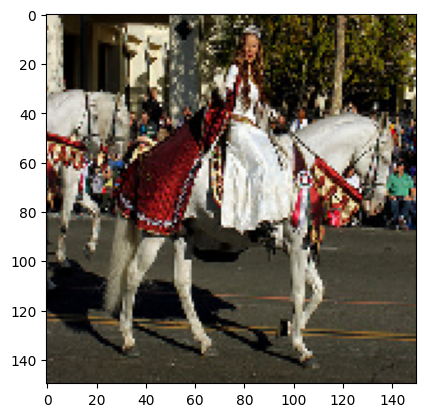

1/1 [==============================] - 0s 46ms/step
Cuc


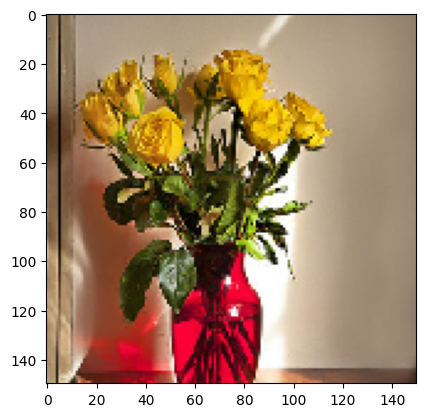

1/1 [==============================] - 0s 32ms/step
Cuc


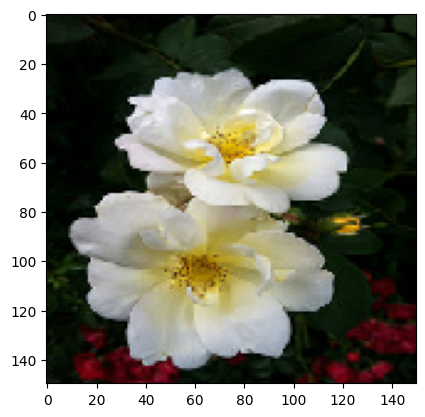

1/1 [==============================] - 0s 36ms/step
Cuc


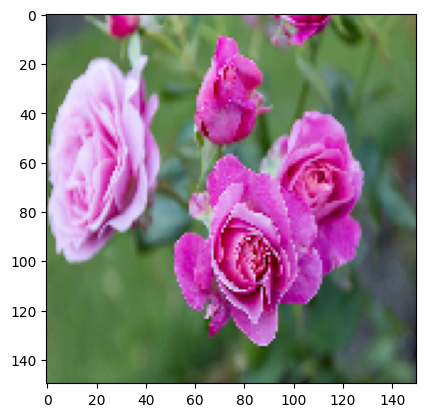

1/1 [==============================] - 0s 26ms/step
Cuc


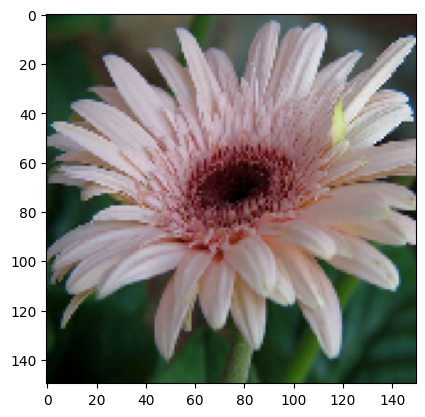

1/1 [==============================] - 0s 29ms/step
Cuc


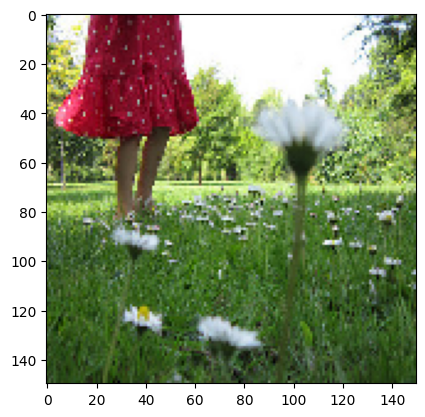

1/1 [==============================] - 0s 28ms/step
Cuc


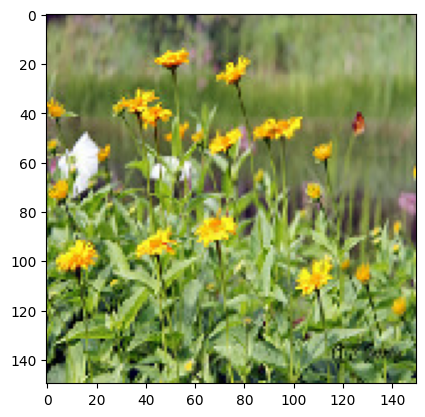

1/1 [==============================] - 0s 25ms/step
Cuc


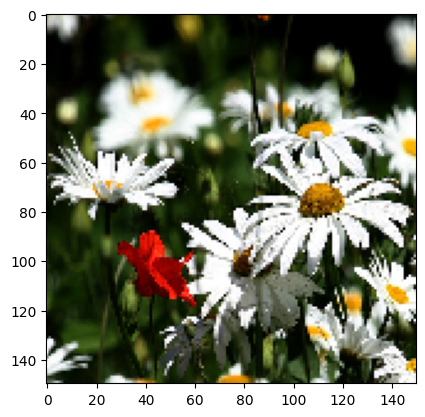

1/1 [==============================] - 0s 26ms/step
Cuc


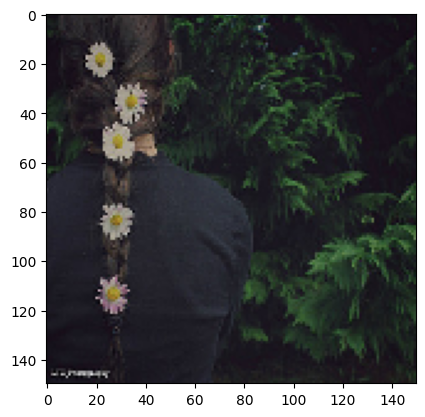

1/1 [==============================] - 0s 25ms/step
Cuc


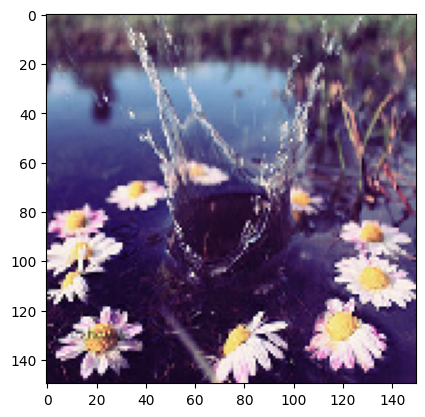

1/1 [==============================] - 0s 25ms/step
Cuc


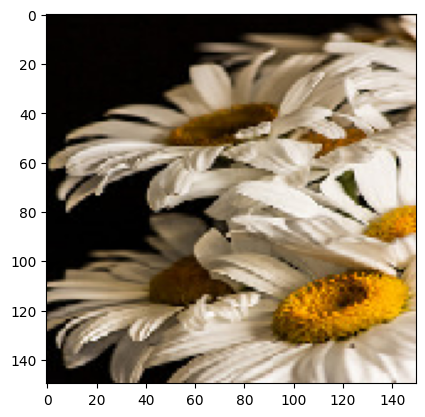

1/1 [==============================] - 0s 24ms/step
Cuc


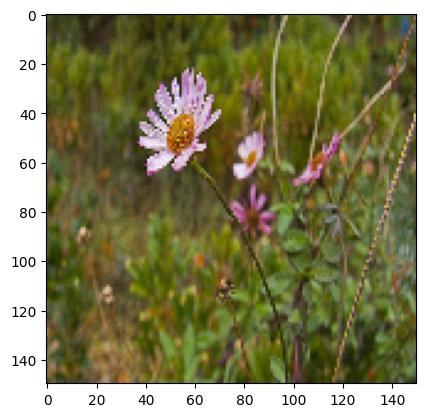

1/1 [==============================] - 0s 24ms/step
Cuc


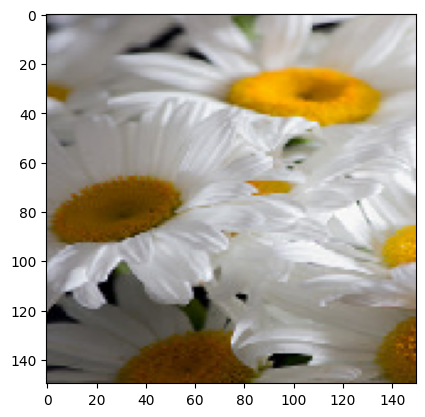

1/1 [==============================] - 0s 24ms/step
Cuc


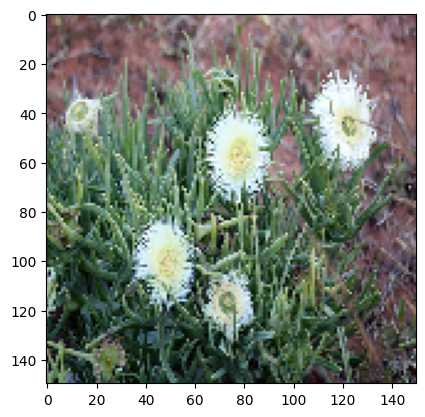

1/1 [==============================] - 0s 24ms/step
Cuc


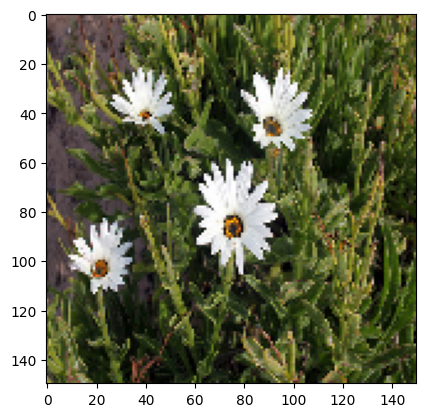

1/1 [==============================] - 0s 26ms/step
Cuc


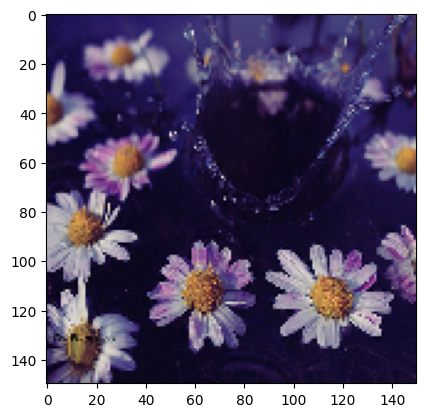

1/1 [==============================] - 0s 25ms/step
Cuc


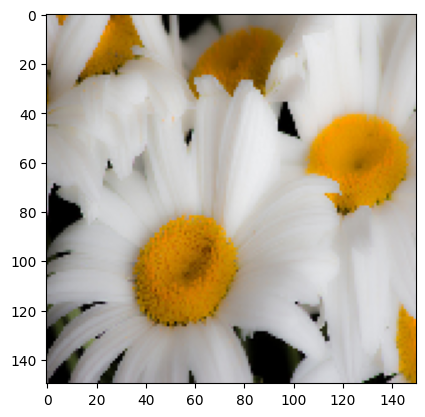

1/1 [==============================] - 0s 24ms/step
Cuc


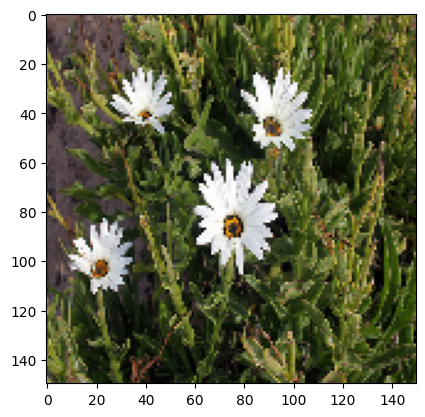

1/1 [==============================] - 0s 25ms/step
Boconganh


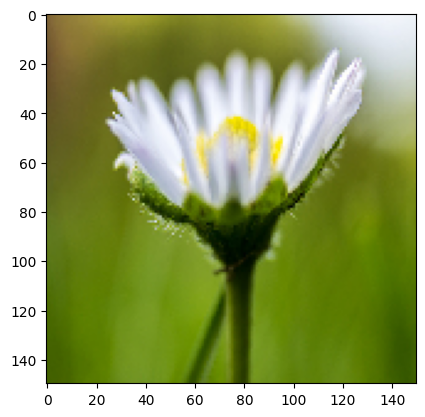

1/1 [==============================] - 0s 30ms/step
Cuc


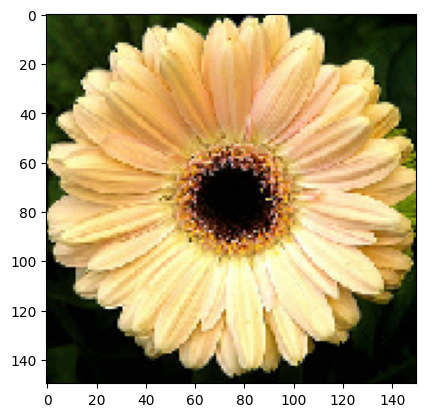

1/1 [==============================] - 0s 25ms/step
Cuc


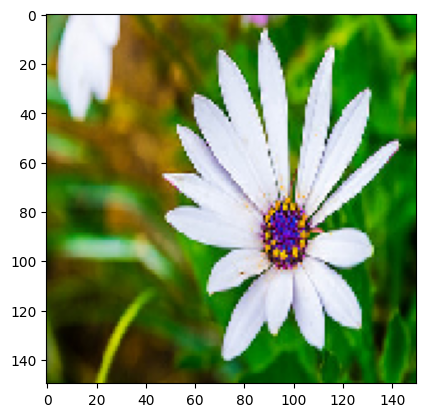

1/1 [==============================] - 0s 27ms/step
Cuc


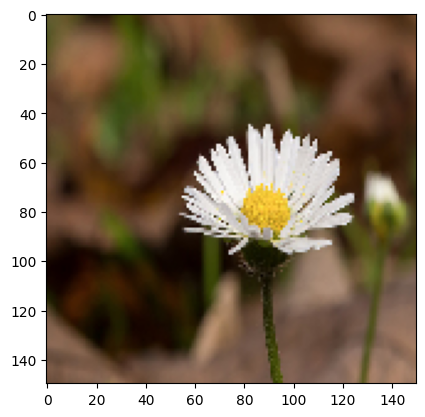

1/1 [==============================] - 0s 27ms/step
Cuc


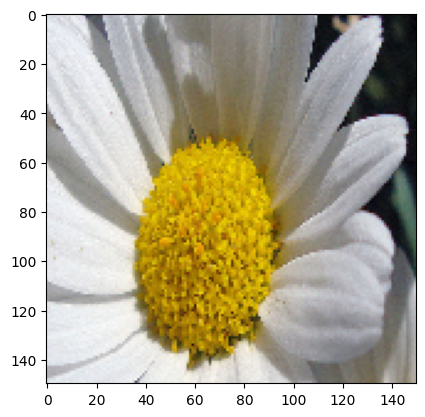

1/1 [==============================] - 0s 25ms/step
Cuc


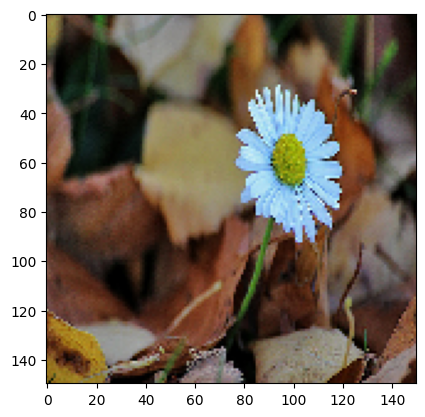

1/1 [==============================] - 0s 25ms/step
Cuc


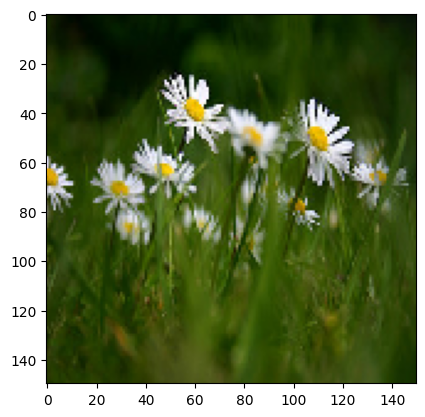

1/1 [==============================] - 0s 25ms/step
Cuc


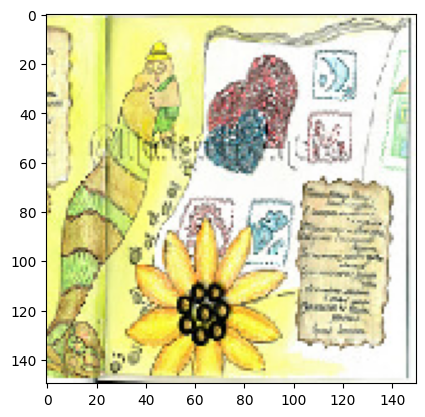

1/1 [==============================] - 0s 42ms/step
huongduong


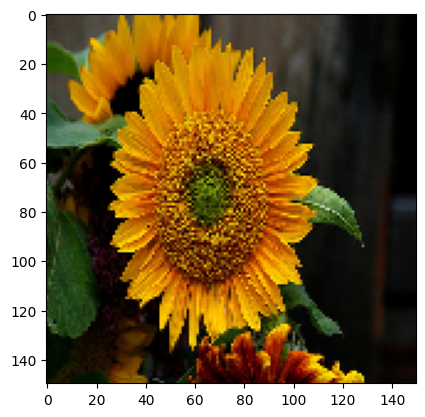

1/1 [==============================] - 0s 50ms/step
huongduong


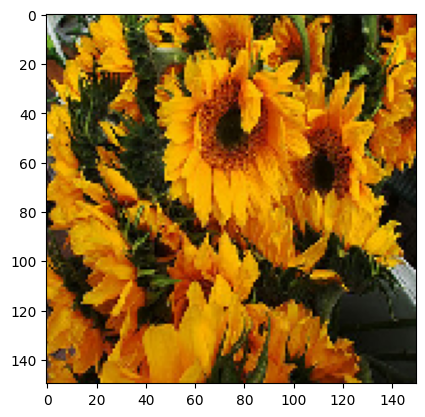

1/1 [==============================] - 0s 32ms/step
huongduong


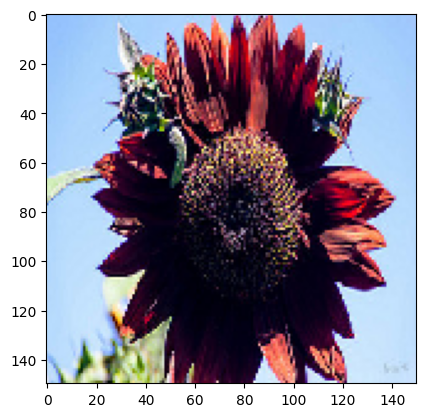

1/1 [==============================] - 0s 46ms/step
huongduong


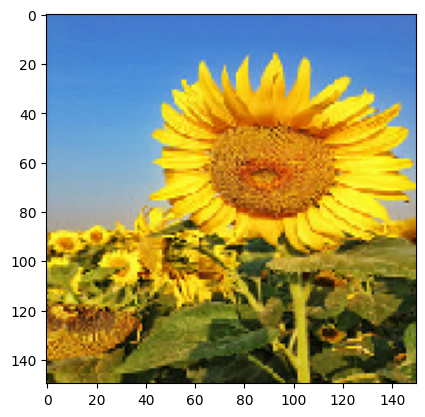

1/1 [==============================] - 0s 32ms/step
Cuc


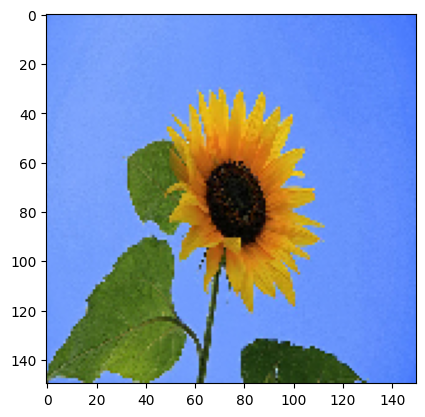

1/1 [==============================] - 0s 56ms/step
Cuc


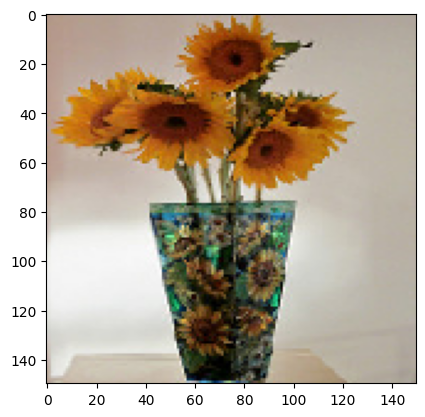

1/1 [==============================] - 0s 40ms/step
Cuc


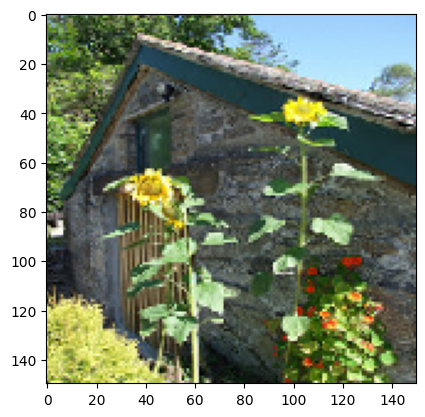

1/1 [==============================] - 0s 35ms/step
huongduong


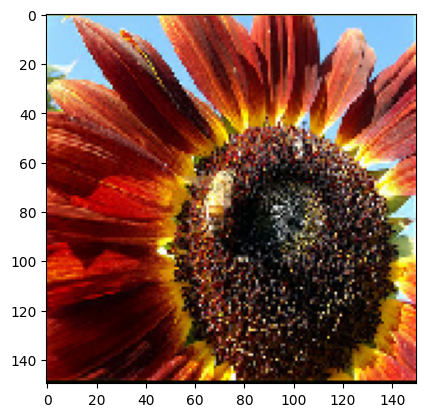

1/1 [==============================] - 0s 32ms/step
huongduong


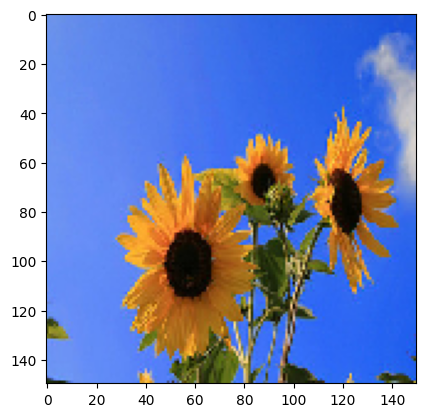

1/1 [==============================] - 0s 34ms/step
huongduong


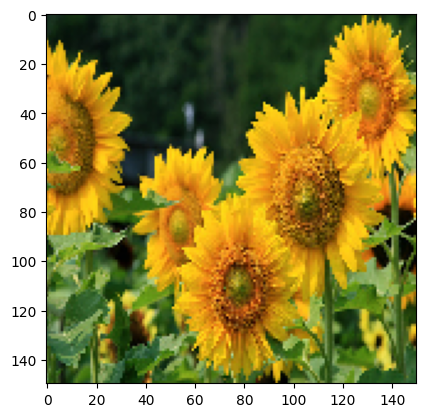

1/1 [==============================] - 0s 31ms/step
Hong


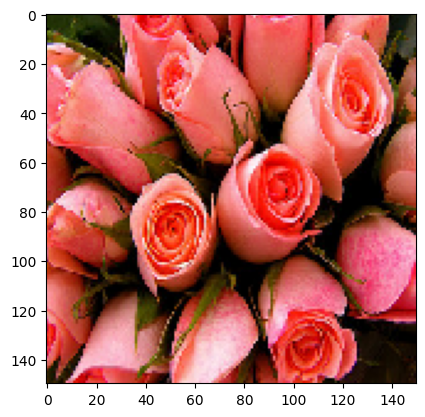

1/1 [==============================] - 0s 26ms/step
Cuc


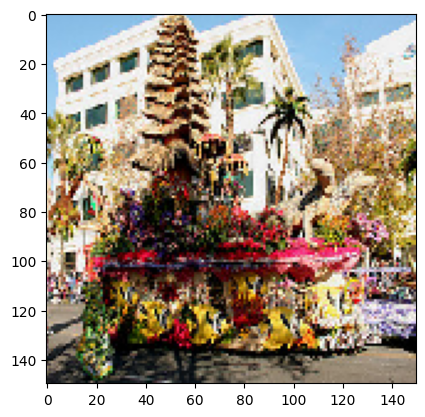

1/1 [==============================] - 0s 29ms/step
Cuc


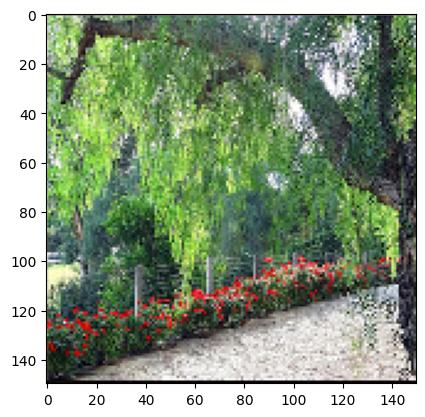

1/1 [==============================] - 0s 26ms/step
Hong


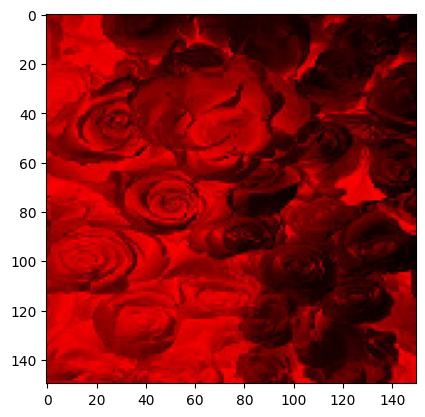

1/1 [==============================] - 0s 27ms/step
Cuc


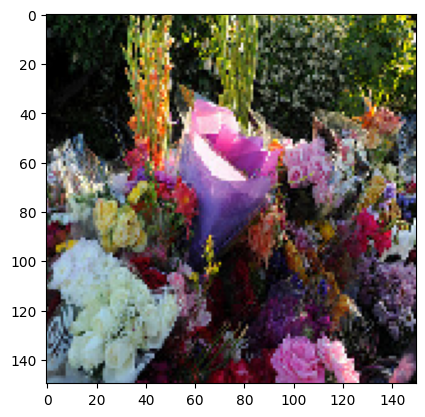

1/1 [==============================] - 0s 26ms/step
Hong


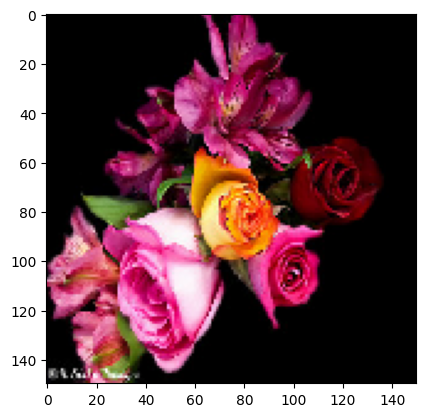

1/1 [==============================] - 0s 27ms/step
Cuc


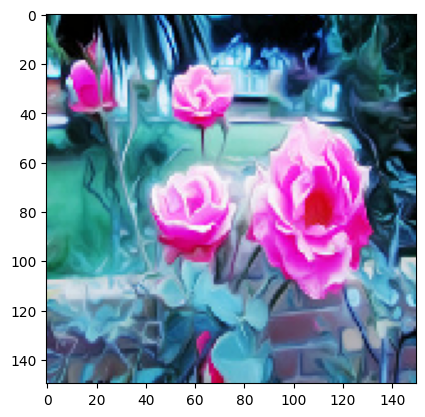

1/1 [==============================] - 0s 32ms/step
Hong


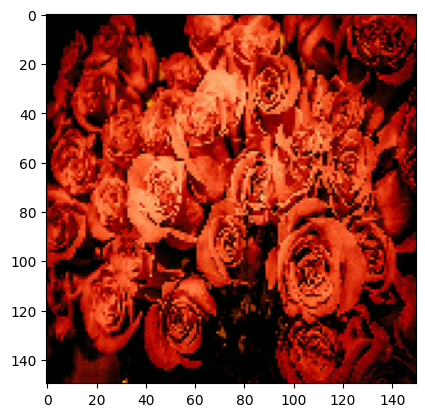

1/1 [==============================] - 0s 25ms/step
Hong


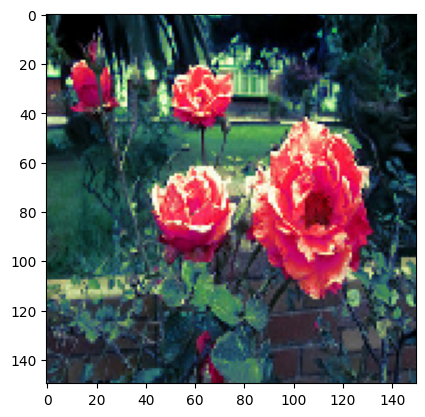

1/1 [==============================] - 0s 25ms/step
Hong


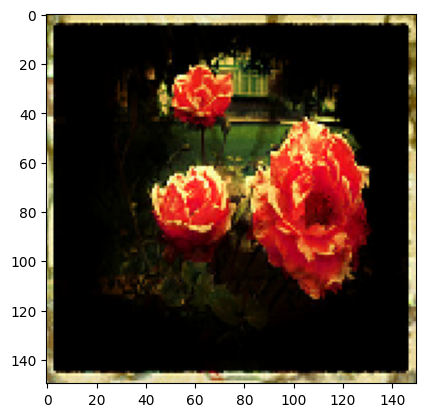

1/1 [==============================] - 0s 27ms/step
Hong


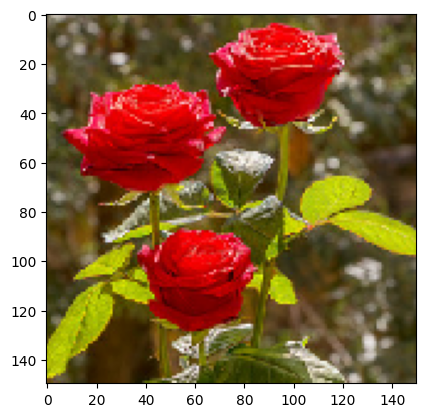

1/1 [==============================] - 0s 25ms/step
Cuc


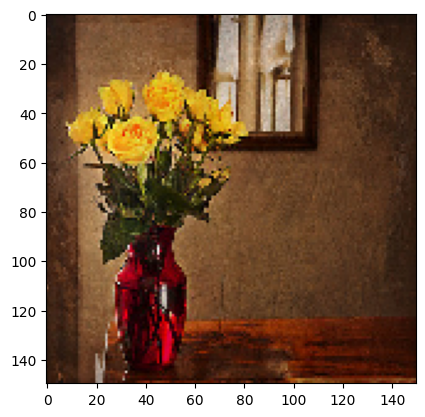

1/1 [==============================] - 0s 24ms/step
Cuc


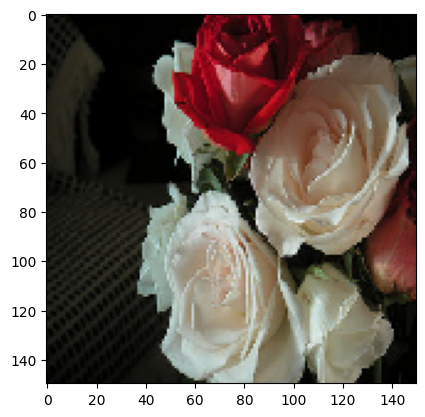

1/1 [==============================] - 0s 26ms/step
Hong


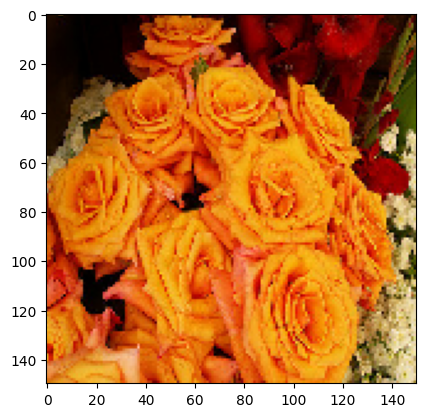

1/1 [==============================] - 0s 25ms/step
Cuc


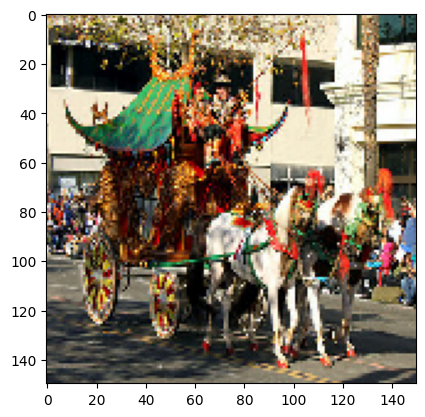

1/1 [==============================] - 0s 25ms/step
huongduong


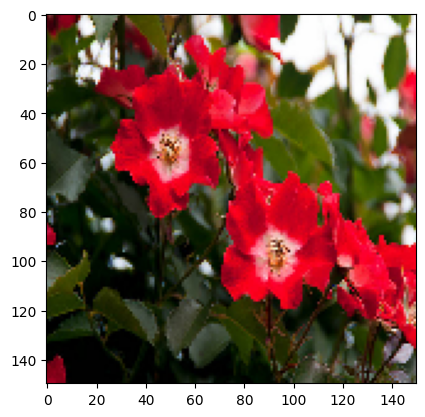

1/1 [==============================] - 0s 25ms/step
Hong


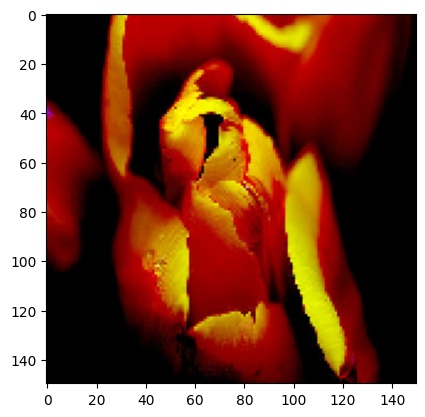

1/1 [==============================] - 0s 26ms/step
Cuc


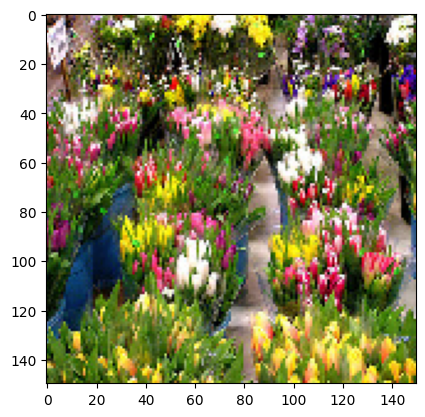

1/1 [==============================] - 0s 25ms/step
huongduong


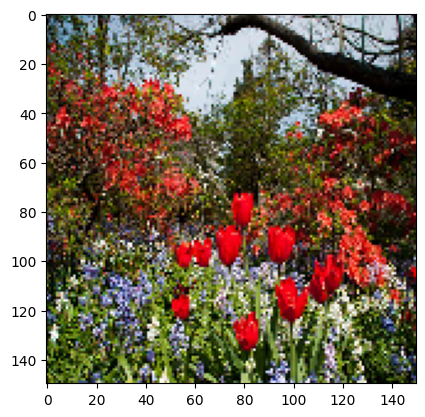

1/1 [==============================] - 0s 26ms/step
tulib


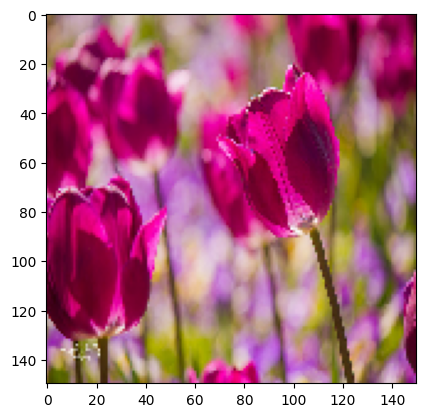

1/1 [==============================] - 0s 32ms/step
huongduong


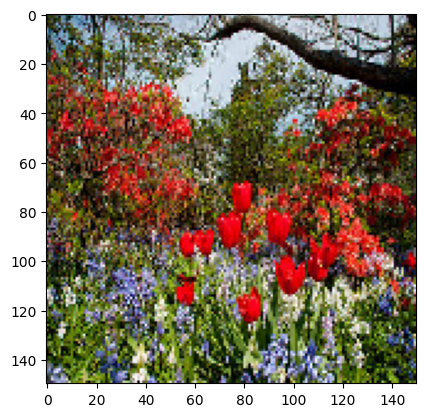

1/1 [==============================] - 0s 24ms/step
tulib


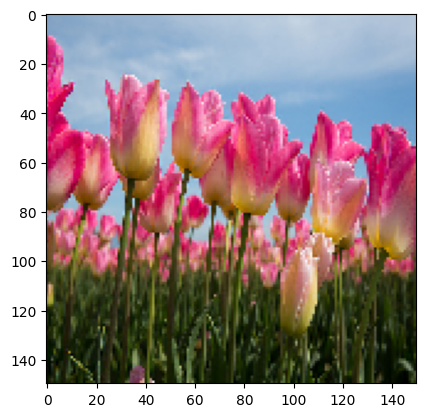

1/1 [==============================] - 0s 26ms/step
Cuc


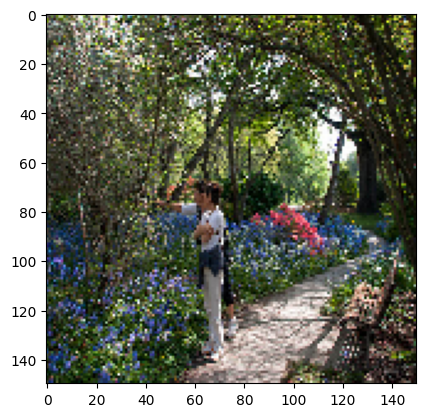

1/1 [==============================] - 0s 25ms/step
Cuc


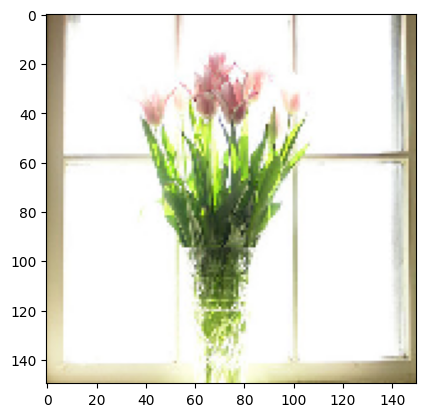

1/1 [==============================] - 0s 30ms/step
Cuc


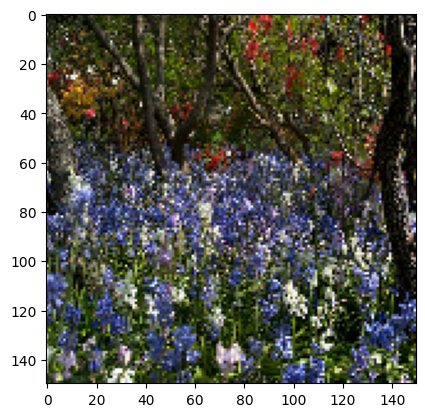

1/1 [==============================] - 0s 32ms/step
tulib


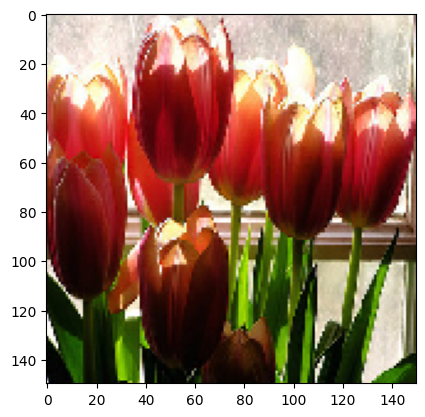

1/1 [==============================] - 0s 32ms/step
Cuc


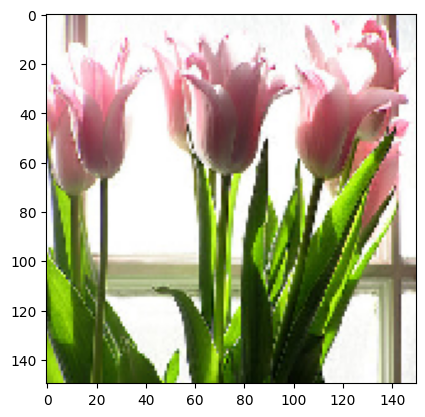

1/1 [==============================] - 0s 51ms/step
tulib


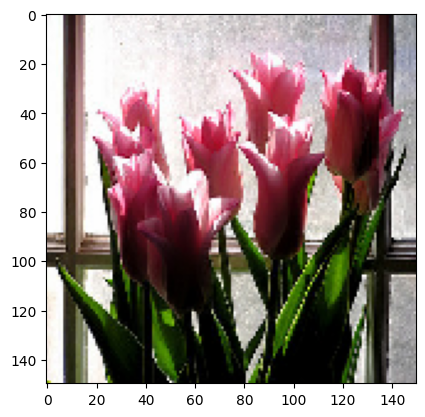

1/1 [==============================] - 0s 26ms/step
tulib


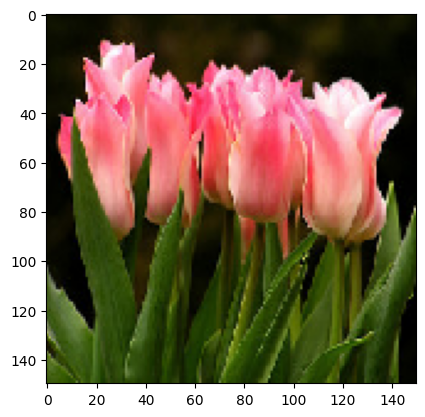

1/1 [==============================] - 0s 38ms/step
Cuc


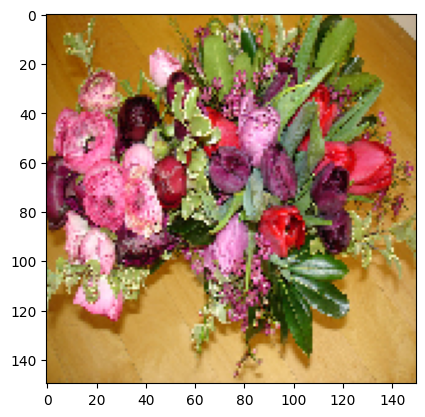

1/1 [==============================] - 0s 54ms/step
huongduong


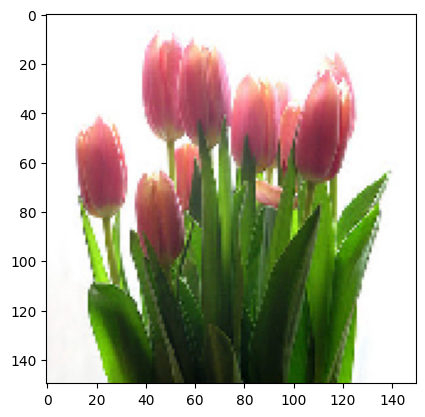

1/1 [==============================] - 0s 61ms/step
tulib


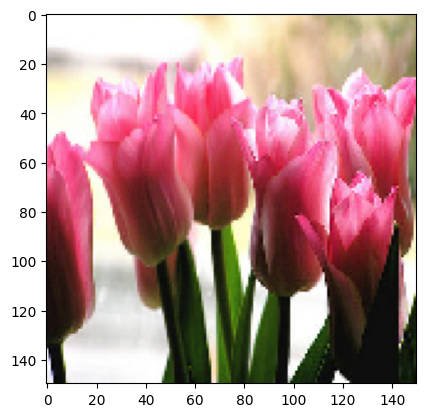

1/1 [==============================] - 0s 48ms/step
tulib


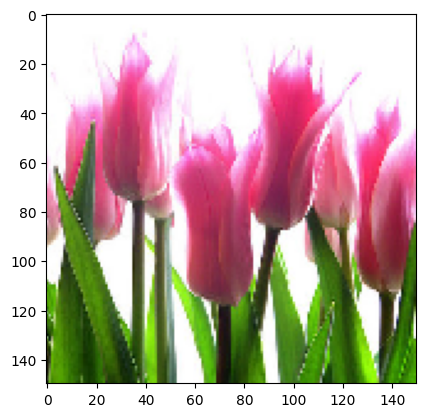

1/1 [==============================] - 0s 25ms/step
Cuc


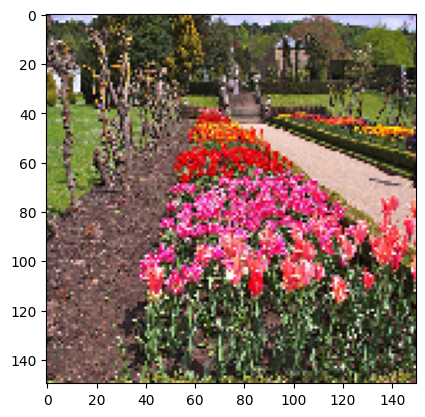

1/1 [==============================] - 0s 60ms/step
Cuc


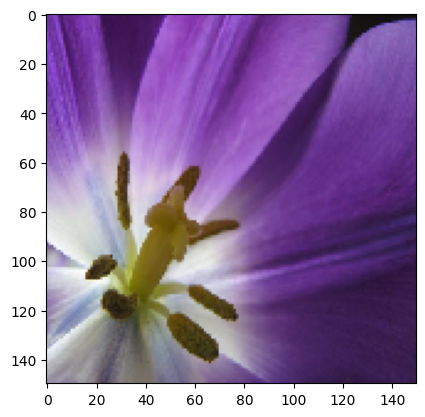

1/1 [==============================] - 0s 33ms/step
tulib


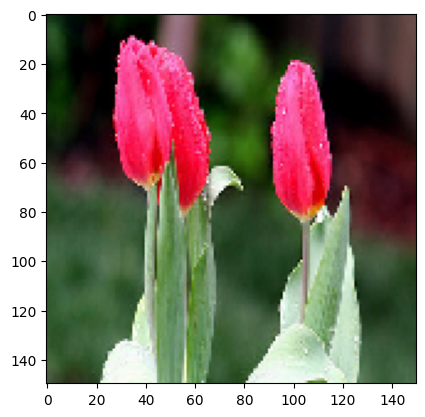

1/1 [==============================] - 0s 28ms/step
huongduong


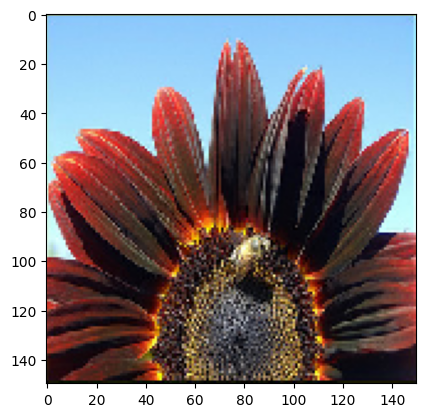

1/1 [==============================] - 0s 30ms/step
huongduong


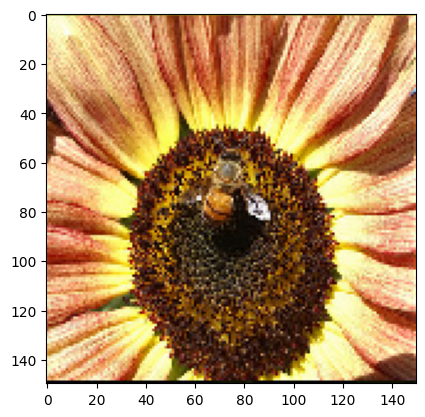

1/1 [==============================] - 0s 30ms/step
huongduong


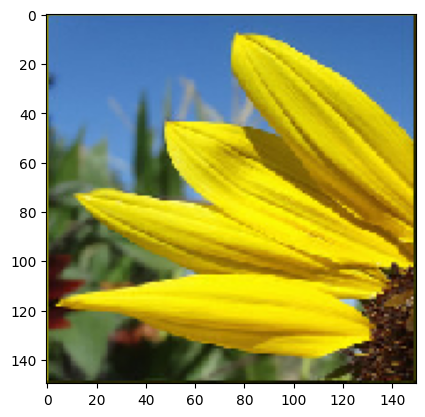

1/1 [==============================] - 0s 29ms/step
huongduong


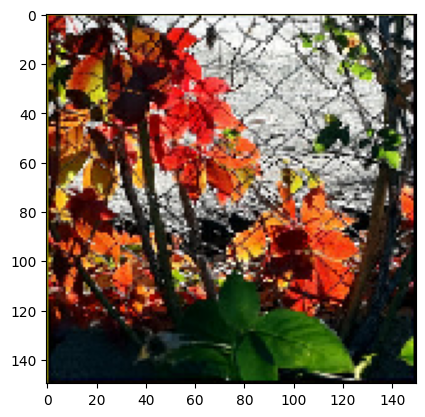

1/1 [==============================] - 0s 26ms/step
huongduong


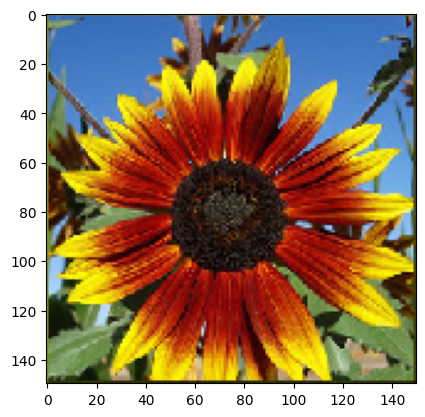

1/1 [==============================] - 0s 26ms/step
Cuc


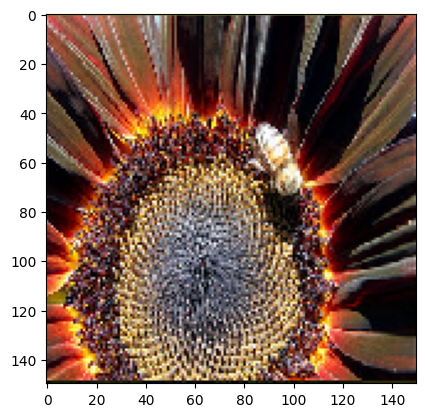

1/1 [==============================] - 0s 26ms/step
Cuc


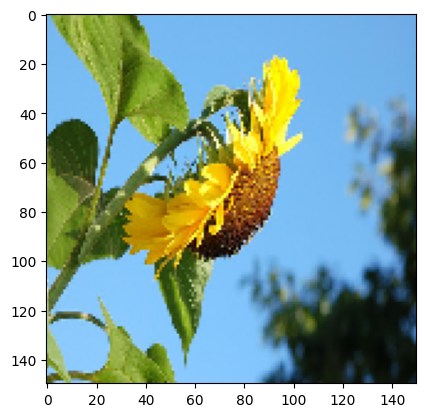

1/1 [==============================] - 0s 26ms/step
Cuc


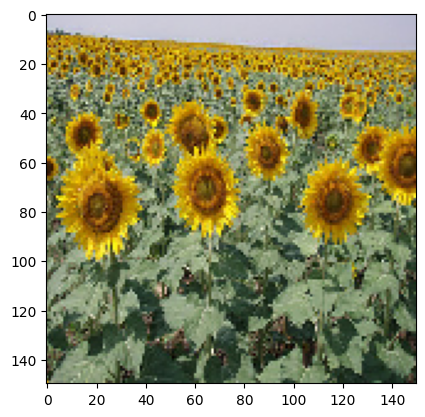

1/1 [==============================] - 0s 30ms/step
huongduong


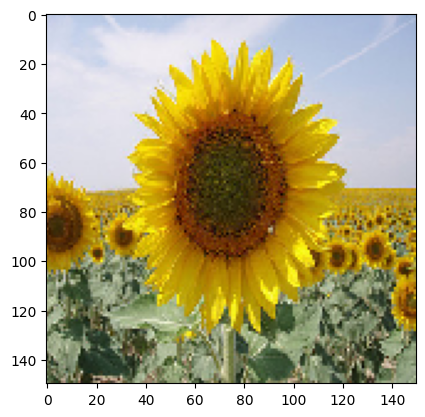

In [55]:
from keras.models import load_model
from keras.utils import load_img, img_to_array
import os
import numpy as np 
test='/content/drive/MyDrive/AI/Data/Flower/Test'

for i in os.listdir(test):
  img=load_img(test+'/'+i,target_size=(150,150))
  plt.imshow(img)
  img=img_to_array(img) 
  img=img.astype('float32') 
  img=img/255 
  img=np.expand_dims(img,axis=0)
  result=(model_1.predict(img).argmax()) 
  class_name=['Boconganh','Cuc','Hong','huongduong','tulib']
  print(class_name[result]) 
  plt.show()